In [ ]:
'''
document 참고
https://mmdetection.readthedocs.io/en/v2.21.0/1_exist_data_model.html

한글폰트 설치법
../dataset/readme.md 참고
'''

In [1]:
import matplotlib.pyplot as plt
plt.rc('font', family='NanumGothicCoding')

import mmcv
from mmdet.apis import init_detector, inference_detector, show_result_pyplot

/opt/conda/envs/project/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def inference_img(config_file, ckpt_file, img_path, score_thr):
    
    # fig, ax = plt.subplots(1, 1, figsize=(12, 10))
    model = init_detector(config_file, ckpt_file, device='cuda:0')

    if not isinstance(img_path, list):
        img_path = [img_path]
    palette=None
    results = []
    for path in img_path:
        
        result = inference_detector(model, path)
        results.append(result)
        model.show_result(path, result, score_thr=score_thr, show=True, 
                          win_name='result', bbox_color=palette,text_color=(200, 200, 200), mask_color=palette)
        plt.show()
    return results

In [3]:
def inference_video(config_file, ckpt_file, video_path, score_thr):
    model = init_detector(config_file, ckpt_file, device='cuda:0')

    video = mmcv.VideoReader(video_path)
    palette=None
    for frame in video:
        result = inference_detector(model, frame)
        model.show_result(frame, result, show=True, score_thr=score_thr,
                          win_name='result', bbox_color=palette,text_color=(200, 200, 200), mask_color=palette)
        break

In [4]:
from glob import glob
config_file = '/opt/ml/new/final-project-level3-cv-12/mmdetection/configs_jina/faster_rcnn/faster_rcnn_r50_fpn_1x_coco.py' # fix config_path
ckpt_file = '/opt/ml/new/final-project-level3-cv-12/mmdetection/work_dirs/faster_rcnn_r50_fpn_1x_coco/latest.pth' # fix ckpt_path

test_files = glob('/opt/ml/project/data/*.jpg') # fix test_path
img_path = [f for f in test_files if f.endswith('jpg')]
# video_path = [f for f in test_files if not f.endswith('jpg')][0]

load checkpoint from local path: /opt/ml/new/final-project-level3-cv-12/mmdetection/work_dirs/faster_rcnn_r50_fpn_1x_coco/latest.pth


/opt/ml/new/final-project-level3-cv-12/mmdetection/mmdet/datasets/utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


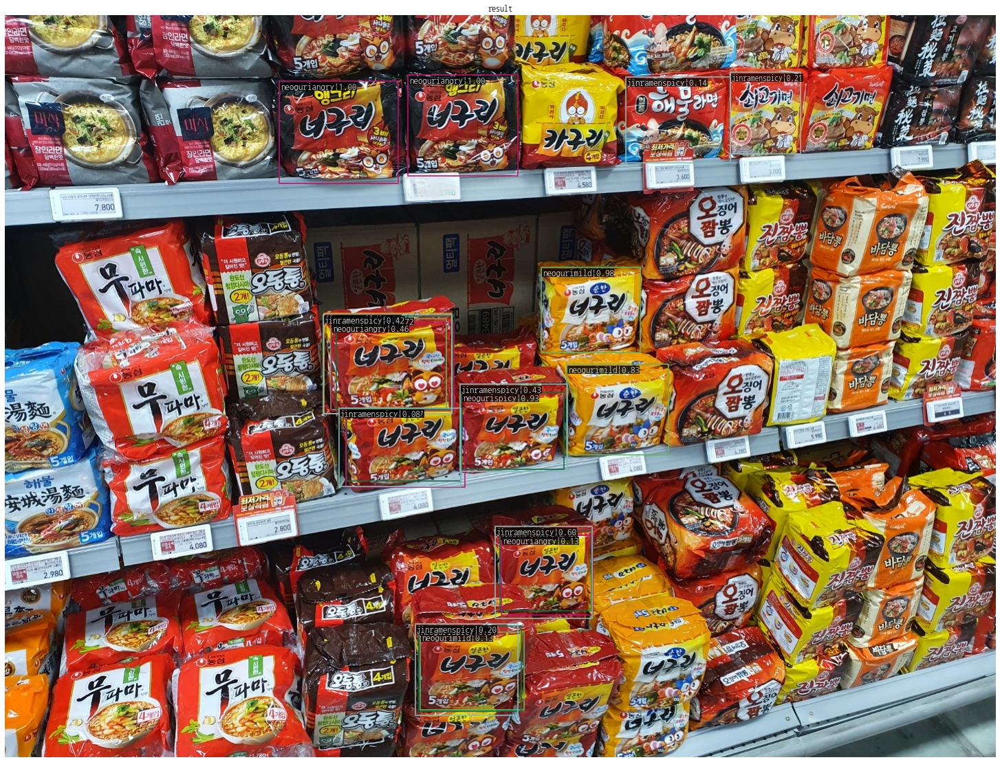

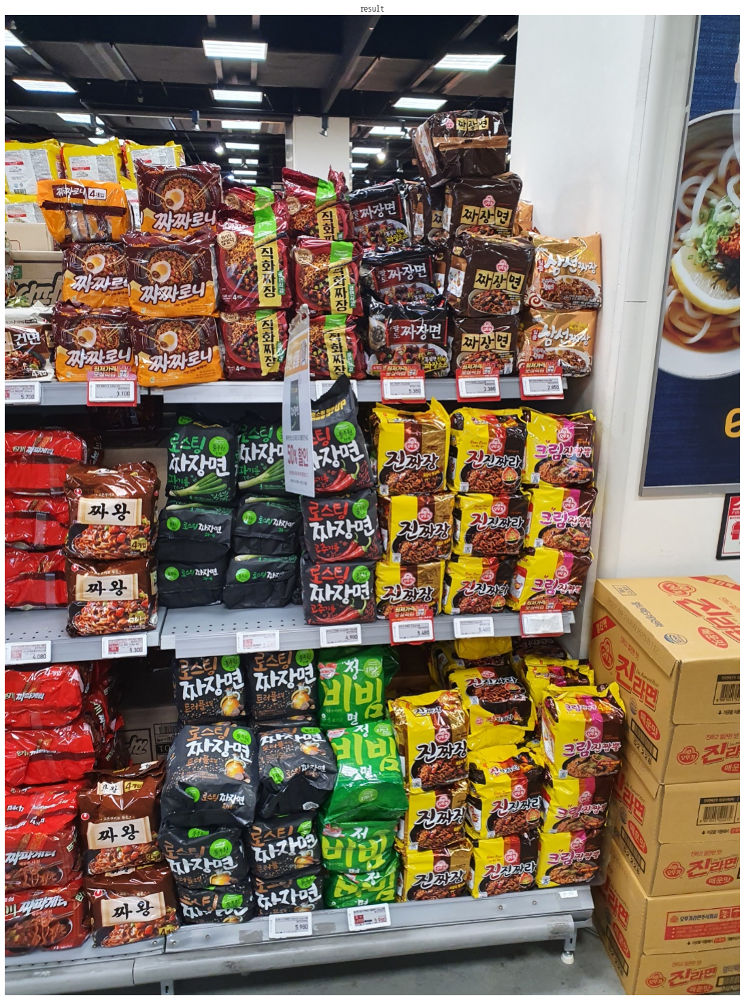

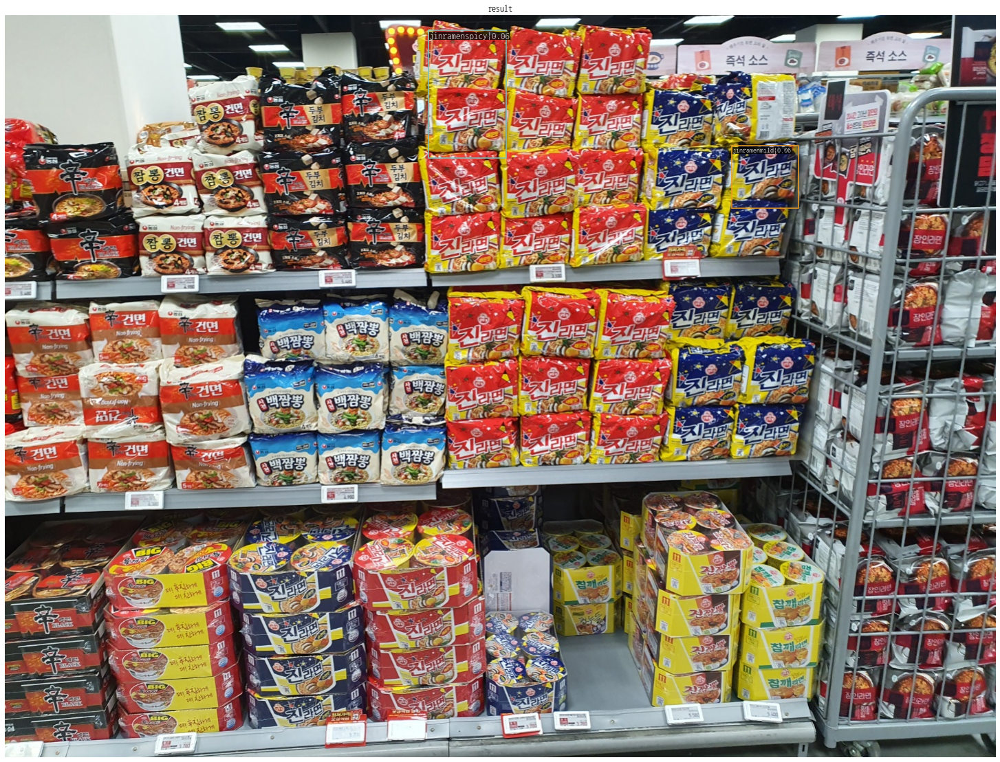

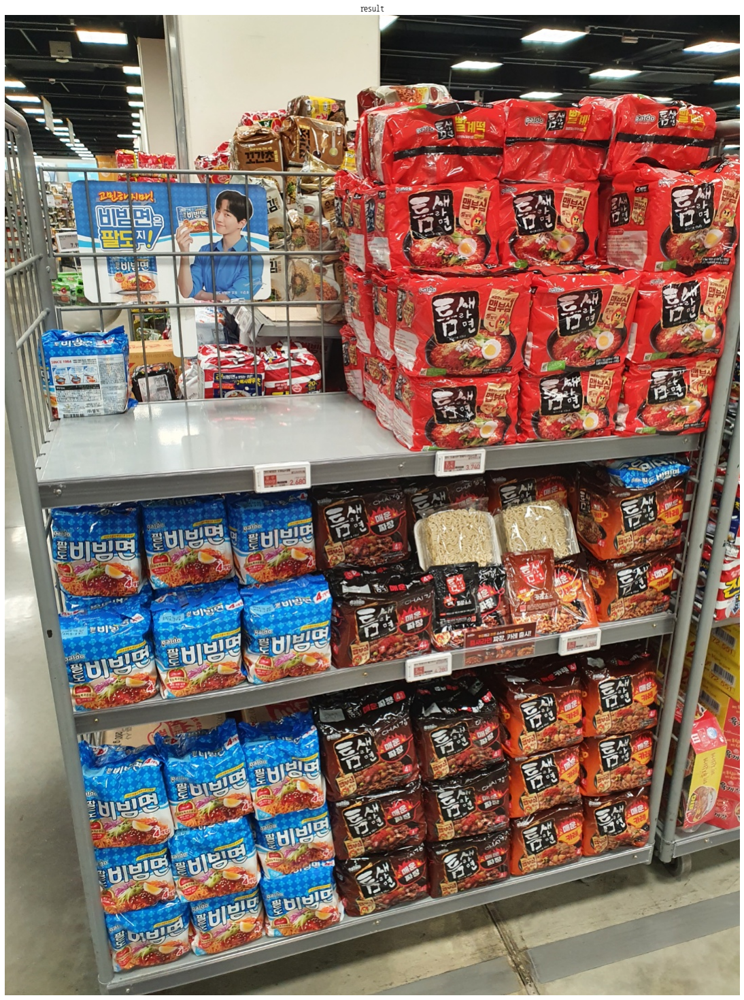

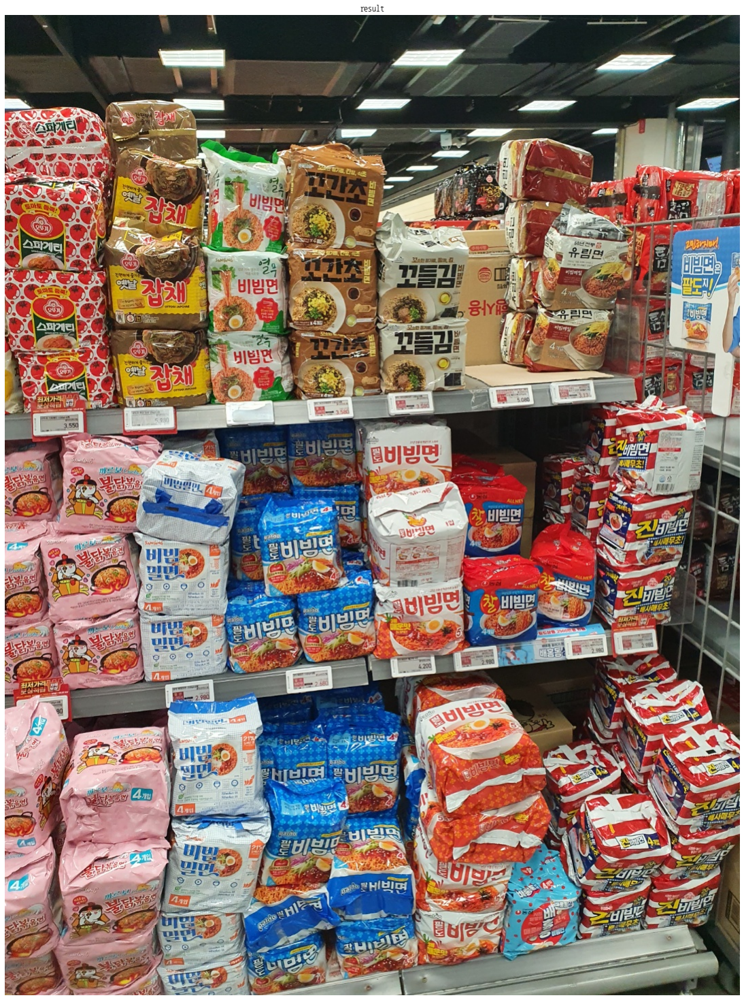

...

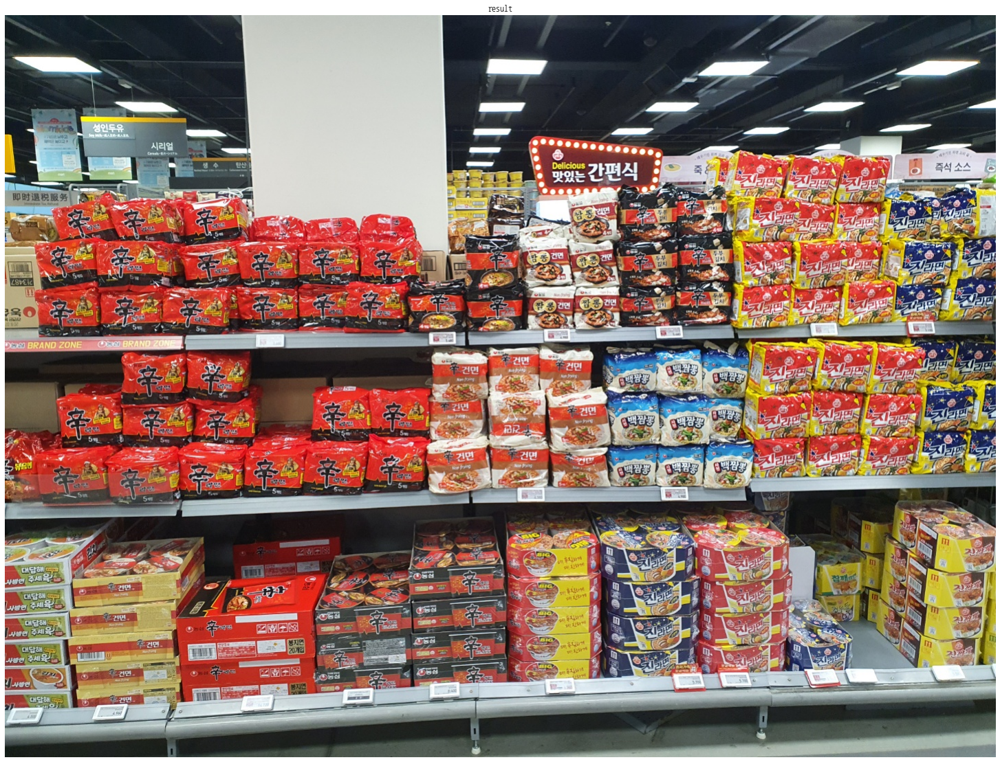

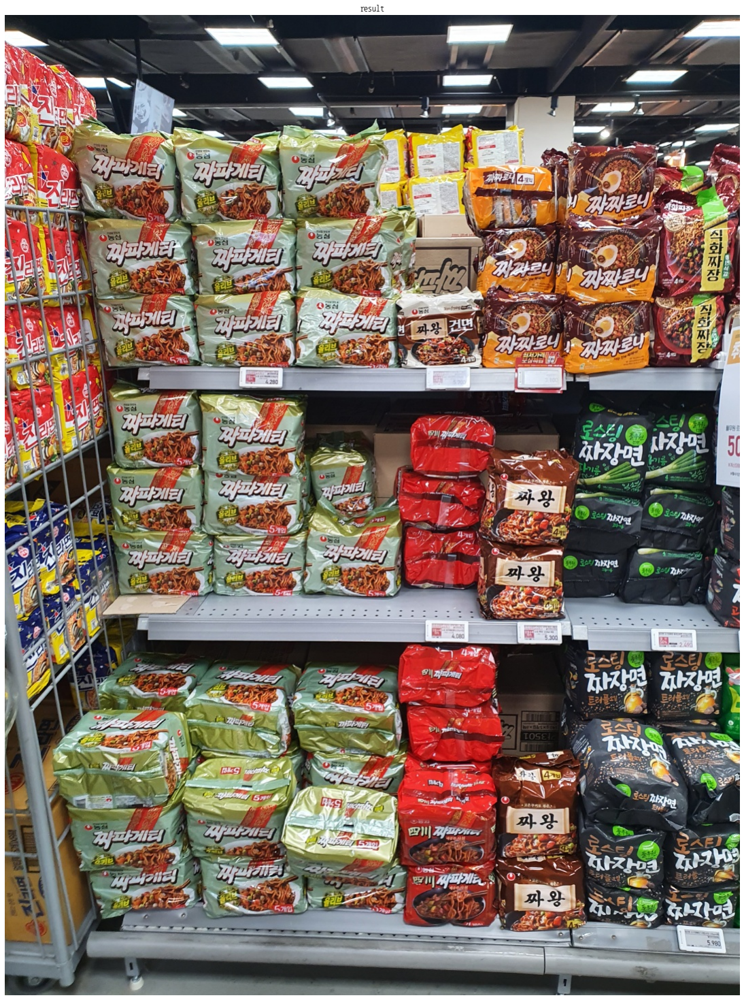

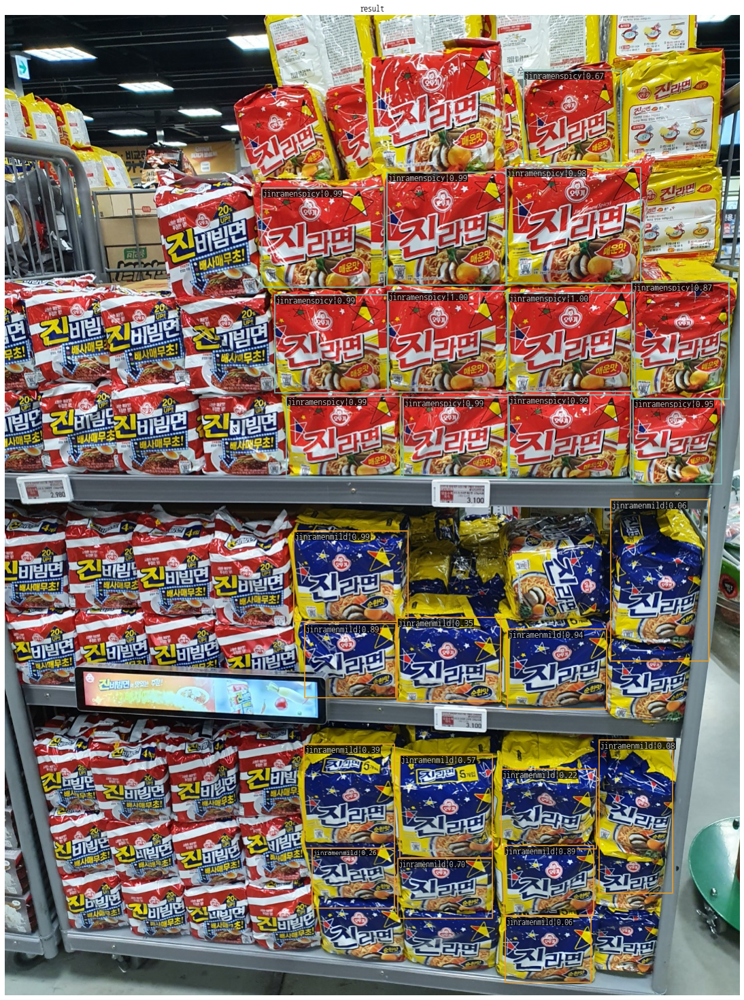

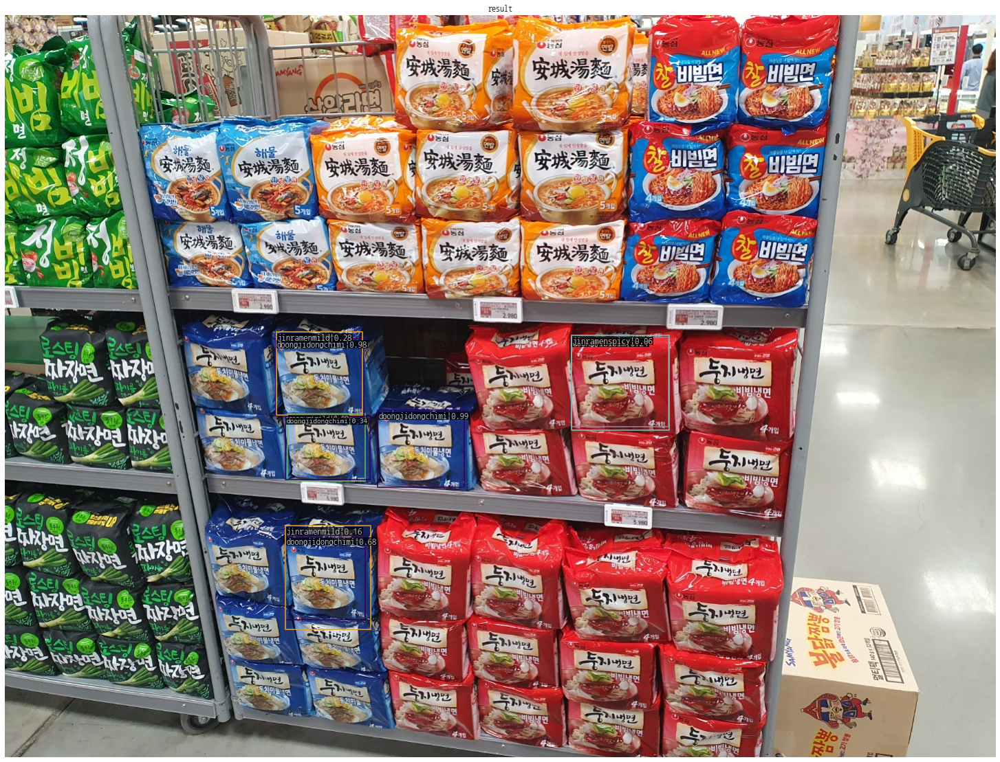

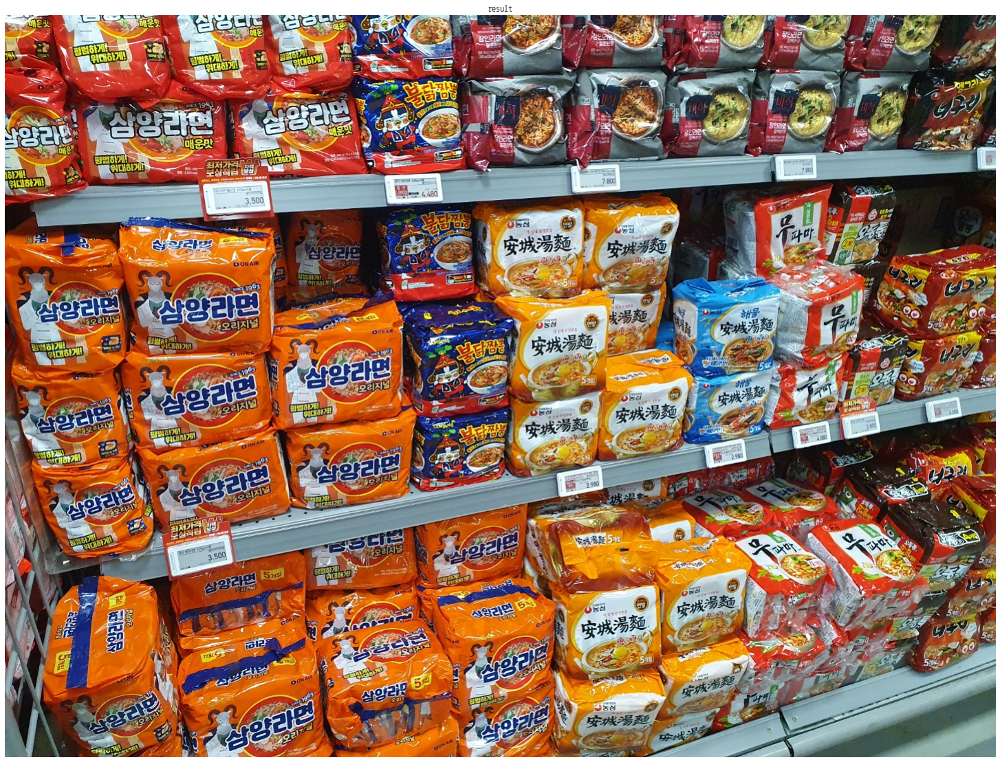

[[array([[7.79772217e+02, 3.67860870e+02, 9.23907227e+02, 4.91233124e+02,
          9.81340528e-01],
         [8.16100708e+02, 5.08789368e+02, 9.64824951e+02, 6.40971069e+02,
          8.34286928e-01],
         [6.03306274e+02, 8.98280518e+02, 7.54721558e+02, 1.01191833e+03,
          1.32545024e-01],
         [4.73861023e+02, 4.42624084e+02, 6.41069214e+02, 5.74466370e+02,
          6.02505244e-02]], dtype=float32),
  array([[7.19760620e+02, 7.50395935e+02, 8.52653870e+02, 8.67794495e+02,
          9.66202319e-01],
         [6.63018799e+02, 5.49254883e+02, 8.12109314e+02, 6.61453491e+02,
          9.34409261e-01],
         [4.96765686e+02, 5.72279663e+02, 6.62640686e+02, 6.78916443e+02,
          9.31554794e-01],
         [4.81474365e+02, 4.38571289e+02, 6.50571167e+02, 5.74169678e+02,
          7.15116620e-01],
         [6.01805786e+02, 8.89500488e+02, 7.50997498e+02, 1.01345807e+03,
          5.40311277e-01]], dtype=float32),
  array([[3.9874832e+02, 9.6659386e+01, 5.7159863e+02, 2.

In [5]:
inference_img(config_file, ckpt_file, img_path, score_thr=0.0001)